Generate samples using checkpoint of model

In [8]:
from sample_mdn import sample_mdn

data_dir = './classical_midi_split/original_embeddings' #location of training data
ckpt_dir = 'checkpoint_45' #location of checkpoint inside of the default save folder 
sample_mdn(data_dir, 
           ckpt_dir)

/home/david/.local/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024-04-12 09:35:45.377781: E external/org_tensorflow/tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:927] could not open file to read NUMA node: /sys/bus/pci/devices/0000:0a:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-12 09:35:45.674447: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


Next, we convert pickled note_sequences to midi files that can be listened to. These generated embedding files are saved in "./sample/mdn".

In the following cell, these embeddings that the model generated are converted into MIDI files that we can listen to.

The MIDI files are saved in './audio'. This folder is organized like so:
```
├─ audio/
│  ├─ gen/
│  │  ├─ audio (contains 10 MIDI files generated by the autoregressive transformer model)
│  ├─ prior/
│  │  ├─ audio (contains 10 MIDI files randomly generated from a Gaussian distribution)/
│  ├─ real/
│  │  ├─ audio (contains 10 MIDI files that were encoded from the original testing dataset)/
```

Convert pickled note_sequences to midi

In [9]:
from sample_audio import sample_audio

sample_audio()

INFO:tensorflow:Building MusicVAE model with BidirectionalLstmEncoder, CategoricalLstmDecoder, and hparams:
{'max_seq_len': 32, 'z_size': 512, 'free_bits': 0, 'max_beta': 0.5, 'beta_rate': 0.99999, 'batch_size': 1, 'grad_clip': 1.0, 'clip_mode': 'global_norm', 'grad_norm_clip_to_zero': 10000, 'learning_rate': 0.001, 'decay_rate': 0.9999, 'min_learning_rate': 1e-05, 'conditional': True, 'dec_rnn_size': [2048, 2048, 2048], 'enc_rnn_size': [2048], 'dropout_keep_prob': 1.0, 'sampling_schedule': 'inverse_sigmoid', 'sampling_rate': 1000, 'use_cudnn': False, 'residual_encoder': False, 'residual_decoder': False, 'control_preprocessing_rnn_size': [256]}


INFO:tensorflow:Building MusicVAE model with BidirectionalLstmEncoder, CategoricalLstmDecoder, and hparams:
{'max_seq_len': 32, 'z_size': 512, 'free_bits': 0, 'max_beta': 0.5, 'beta_rate': 0.99999, 'batch_size': 1, 'grad_clip': 1.0, 'clip_mode': 'global_norm', 'grad_norm_clip_to_zero': 10000, 'learning_rate': 0.001, 'decay_rate': 0.9999, 'min_learning_rate': 1e-05, 'conditional': True, 'dec_rnn_size': [2048, 2048, 2048], 'enc_rnn_size': [2048], 'dropout_keep_prob': 1.0, 'sampling_schedule': 'inverse_sigmoid', 'sampling_rate': 1000, 'use_cudnn': False, 'residual_encoder': False, 'residual_decoder': False, 'control_preprocessing_rnn_size': [256]}


INFO:tensorflow:
Encoder Cells (bidirectional):
  units: [2048]



INFO:tensorflow:
Encoder Cells (bidirectional):
  units: [2048]



INFO:tensorflow:
Decoder Cells:
  units: [2048, 2048, 2048]



INFO:tensorflow:
Decoder Cells:
  units: [2048, 2048, 2048]



Instructions for updating:
Use `tf.cast` instead.


Instructions for updating:
Use `tf.cast` instead.


/home/david/.local/lib/python3.8/site-packages/magenta/models/music_vae/lstm_utils.py:94: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  tf.layers.dense(
/home/david/.local/lib/python3.8/site-packages/magenta/contrib/rnn.py:749: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  self._kernel = self.add_variable(
/home/david/.local/lib/python3.8/site-packages/magenta/contrib/rnn.py:751: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  self._bias = self.add_variable(


Instructions for updating:
Please use `keras.layers.Bidirectional(keras.layers.RNN(cell))`, which is equivalent to this API


Instructions for updating:
Please use `keras.layers.Bidirectional(keras.layers.RNN(cell))`, which is equivalent to this API


Instructions for updating:
Please use `keras.layers.RNN(cell)`, which is equivalent to this API


Instructions for updating:
Please use `keras.layers.RNN(cell)`, which is equivalent to this API


Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.


/home/david/.local/lib/python3.8/site-packages/magenta/models/music_vae/base_model.py:195: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  mu = tf.layers.dense(
/home/david/.local/lib/python3.8/site-packages/magenta/models/music_vae/base_model.py:200: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  sigma = tf.layers.dense(
Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.


INFO:tensorflow:Unbundling checkpoint.


INFO:tensorflow:Unbundling checkpoint.


INFO:tensorflow:Restoring parameters from /tmp/tmp0mj27c52/cat-mel_2bar_big.ckpt


INFO:tensorflow:Restoring parameters from /tmp/tmp0mj27c52/cat-mel_2bar_big.ckpt


(100, 16, 512)


We can generate the normalized version of the embedding for analysis purposes, next.
The embeddings are shape (100,16,42) which represents (number of sequences, sequence_length, 42 dimensional embeddings)

In [14]:
import numpy as np
from sample_mdn import sample_mdn

real_data, generated_data = sample_mdn('./classical_midi_split/original_embeddings', 
           ckpt_dir = './checkpoint_33', flush=False)

print(real_data.shape, generated_data.shape)

2024-04-12 09:30:25.473536: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


(100, 16, 42) (100, 16, 42)


In [15]:
#We generate a random embedding for comparison purposes
random_data = np.random.rand(*generated_data.shape)

Calculating similarity between the embeddings generated by the model and the embeddings corresponding to the test data using Frechet Distance and Maximum Mean Discrepancy. 

A lower Frechet Distance and Maximum Mean Discrepancy metric indicates higher similarity between the embeddings. That is to say, the lower these metrics are between the real test data and the generated data, the better the model is "copying" the underlying distribution of the test music data.

Using checkpoint for epoch 33, the results are below. 

In [16]:
from utils.metrics import frechet_distance

avg_FD_gen = 0
avg_FD_rand = 0

for i in range(100):
    avg_FD_gen += frechet_distance(real=real_data[i], fake=generated_data[i])
    avg_FD_rand += frechet_distance(real=real_data[i], fake=random_data[i])

avg_FD_gen = avg_FD_gen/100
avg_FD_rand = avg_FD_rand/100
print(avg_FD_gen, avg_FD_rand)

2.1969281397272495 10.06293339165404


In [17]:
from utils.metrics import mmd_rbf
avg_mmd_gen = 0
avg_mmd_rand = 0

for i in range(100):
    avg_mmd_gen += mmd_rbf(real=real_data[i], fake=generated_data[i])
    avg_mmd_rand += mmd_rbf(real=real_data[i], fake=random_data[i])

avg_mmd_gen = avg_mmd_gen/100
avg_mmd_rand = avg_mmd_rand/100
print(avg_mmd_gen, avg_mmd_rand)

0.1719655506685376 0.16710466495867343


As you can see, the generated samples perform better than the random baseline in learning the underlying distribution in the testing data. 

We may also try epoch 45 and calculate the same metrics below.

In [18]:
import numpy as np
from utils.metrics import frechet_distance
from utils.metrics import mmd_rbf

real_data, generated_data = sample_mdn('./classical_midi_split/original_embeddings', 
           ckpt_dir = './checkpoint_45', flush=False)

avg_FD_gen = 0
avg_FD_rand = 0

for i in range(100):
    avg_FD_gen += frechet_distance(real=real_data[i], fake=generated_data[i])
    avg_FD_rand += frechet_distance(real=real_data[i], fake=random_data[i])

avg_FD_gen = avg_FD_gen/100
avg_FD_rand = avg_FD_rand/100
print("The average Frechet distance for the generated and random samples are:", avg_FD_gen, avg_FD_rand)

avg_mmd_gen = 0
avg_mmd_rand = 0

for i in range(100):
    avg_mmd_gen += mmd_rbf(real=real_data[i], fake=generated_data[i])
    avg_mmd_rand += mmd_rbf(real=real_data[i], fake=random_data[i])

avg_mmd_gen = avg_mmd_gen/100
avg_mmd_rand = avg_mmd_rand/100
print("The average Mean value discrepancy between the generated and random samples are:", avg_mmd_gen, avg_mmd_rand)

2024-04-12 09:30:37.287569: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


The average Frechet distance for the generated and random samples are: 25.16476976516516 9.992428278892222
The average Mean value discrepancy between the generated and random samples are: 0.2886489505507052 0.16385478452027688


For epoch 45, the model performs poorer than the baseline. So objectively, this suggests that the model reaches its best performance around epoch 33 for these metrics, before either overfitting or getting stuck at a local minimum around epoch 45. These two metrics on their own merely capture similarity between the samples though, and don't represent evidence of musical patterns or pleasantness. We can also try epoch 28:

In [19]:
real_data, generated_data = sample_mdn('./classical_midi_split/original_embeddings', 
           ckpt_dir = './checkpoint_28', flush=False)

avg_FD_gen = 0
avg_FD_rand = 0

for i in range(100):
    avg_FD_gen += frechet_distance(real=real_data[i], fake=generated_data[i])
    avg_FD_rand += frechet_distance(real=real_data[i], fake=random_data[i])

avg_FD_gen = avg_FD_gen/100
avg_FD_rand = avg_FD_rand/100
print("The average Frechet distance for the generated and random samples are:", avg_FD_gen, avg_FD_rand)

avg_mmd_gen = 0
avg_mmd_rand = 0

for i in range(100):
    avg_mmd_gen += mmd_rbf(real=real_data[i], fake=generated_data[i])
    avg_mmd_rand += mmd_rbf(real=real_data[i], fake=random_data[i])

avg_mmd_gen = avg_mmd_gen/100
avg_mmd_rand = avg_mmd_rand/100
print("The average Mean value discrepancy between the generated and random samples are:", avg_mmd_gen, avg_mmd_rand)

2024-04-12 09:31:37.575066: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


The average Frechet distance for the generated and random samples are: 2.229256623279041 9.962285686994841
The average Mean value discrepancy between the generated and random samples are: 0.17790391344577075 0.1649298970638331


Next, we retreive note sequences from the generated MIDI files from the 2nd code cell for further analysis:

In [ ]:
!python3 .local/lib/python3.8/site-packages/magenta/scripts/convert_dir_to_note_sequences.py   \
    --input_dir='/path/to/ECE324/audio/gen/audio'   \
    --output_file='/path/to/ECE324/audio/gen/ns/ns_gen.tfrecord'   \
    --recursive

!python3 .local/lib/python3.8/site-packages/magenta/scripts/convert_dir_to_note_sequences.py   \
    --input_dir='/path/to/ECE324/audio/prior/audio'   \
    --output_file='/path/to/ECE324/audio/prior/ns/ns_prior.tfrecord'   \
    --recursive

!python3 .local/lib/python3.8/site-packages/magenta/scripts/convert_dir_to_note_sequences.py   \
    --input_dir='/path/to/ECE324/audio/real/audio'   \
    --output_file='/path/to/ECE324/audio/real/ns/ns_real.tfrecord'   \
    --recursive

#if magic does not work, use command line

Next, we can visualize some of the statistics for the generated MIDI files

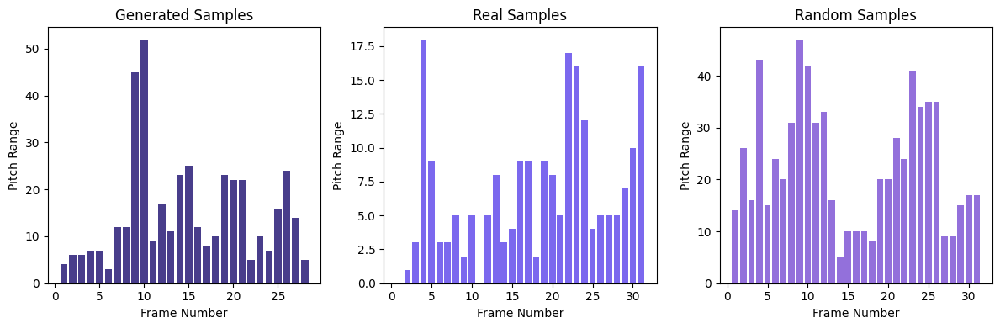

In [10]:
import pickle
from utils.metrics import perceptual_midi_histograms
import matplotlib.pyplot as plt
import numpy as np

gen_note_seq = open('audio/gen/ns/2.pkl', 'rb')
gen_note_seq = pickle.load(gen_note_seq)
real_note_seq = open('audio/real/ns/2.pkl', 'rb')
real_note_seq = pickle.load(real_note_seq)
rand_note_seq = open('audio/prior/ns/2.pkl', 'rb')
rand_note_seq = pickle.load(rand_note_seq)
#print(note_seq)

#generating historgram for dict using 5 sec intervals 
#going to plot pitch range, mean pitch, variation of pitch, mean note duration, var of note duration
histogram_gen = perceptual_midi_histograms(gen_note_seq)
histogram_real = perceptual_midi_histograms(real_note_seq)
histogram_rand = perceptual_midi_histograms(rand_note_seq)

plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.bar(np.arange(1, len(histogram_gen['pr'])+1), histogram_gen['pr'], color='darkslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Pitch Range')
plt.title("Generated Samples")

plt.subplot(1,3,2)
plt.bar(np.arange(1, len(histogram_real['pr'])+1), histogram_real['pr'], color='mediumslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Pitch Range')
plt.title("Real Samples")

plt.subplot(1,3,3)
plt.bar(np.arange(1, len(histogram_rand['pr'])+1), histogram_rand['pr'], color='mediumpurple')
plt.xlabel('Frame Number')
plt.ylabel('Pitch Range')
plt.title("Random Samples")

plt.tight_layout()
plt.show()

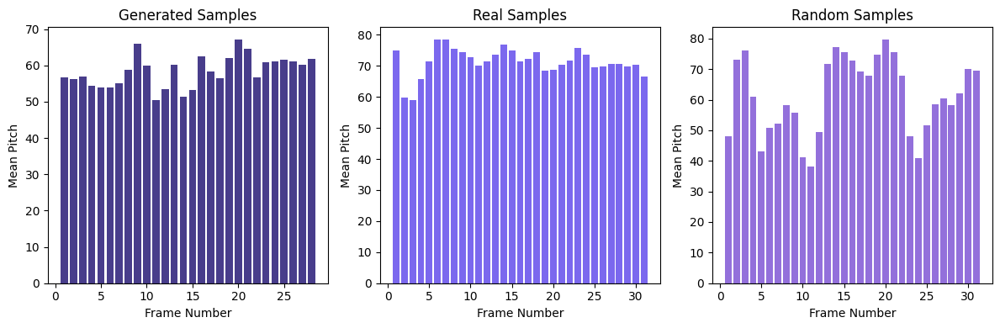

In [11]:
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.bar(np.arange(1, len(histogram_gen['mp'])+1), histogram_gen['mp'], color='darkslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Mean Pitch')
plt.title("Generated Samples")

plt.subplot(1,3,2)
plt.bar(np.arange(1, len(histogram_real['mp'])+1), histogram_real['mp'], color='mediumslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Mean Pitch')
plt.title("Real Samples")

plt.subplot(1,3,3)
plt.bar(np.arange(1, len(histogram_rand['mp'])+1), histogram_rand['mp'], color='mediumpurple')
plt.xlabel('Frame Number')
plt.ylabel('Mean Pitch')
plt.title("Random Samples")

plt.tight_layout()
plt.show()

In general, smaller pitch variation in short time frames is more melodic and pleasant to the ear.

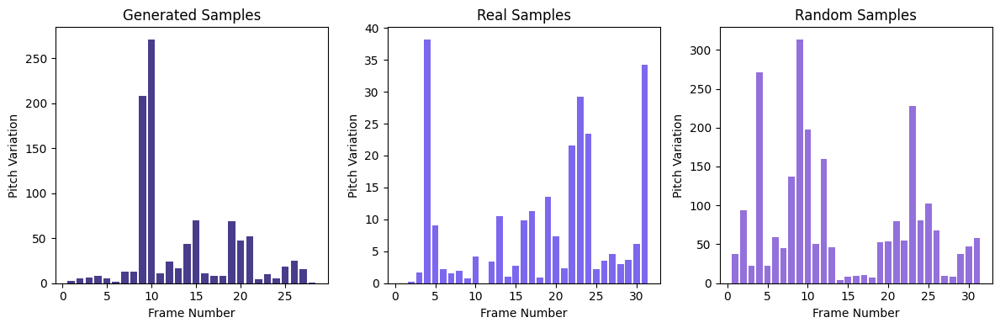

In [12]:
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.bar(np.arange(1, len(histogram_gen['vp'])+1), histogram_gen['vp'], color='darkslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Pitch Variation')
plt.title("Generated Samples")

plt.subplot(1,3,2)
plt.bar(np.arange(1, len(histogram_real['vp'])+1), histogram_real['vp'], color='mediumslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Pitch Variation')
plt.title("Real Samples")

plt.subplot(1,3,3)
plt.bar(np.arange(1, len(histogram_rand['vp'])+1), histogram_rand['vp'], color='mediumpurple')
plt.xlabel('Frame Number')
plt.ylabel('Pitch Variation')
plt.title("Random Samples")

plt.tight_layout()
plt.show()

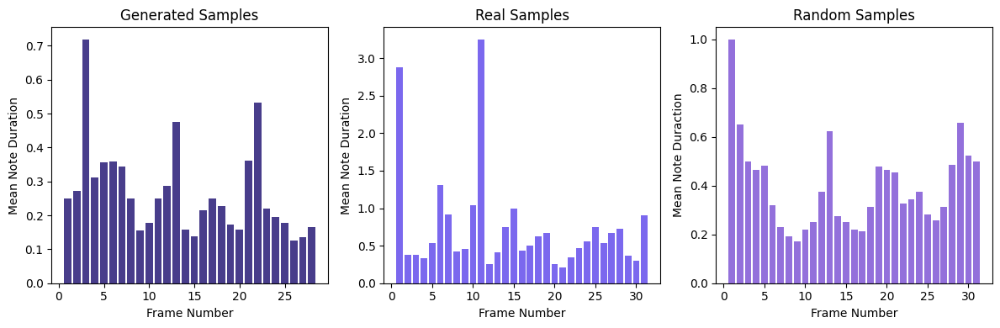

In [13]:
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.bar(np.arange(1, len(histogram_gen['md'])+1), histogram_gen['md'], color='darkslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Mean Note Duration')
plt.title("Generated Samples")

plt.subplot(1,3,2)
plt.bar(np.arange(1, len(histogram_real['md'])+1), histogram_real['md'], color='mediumslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Mean Note Duration')
plt.title("Real Samples")

plt.subplot(1,3,3)
plt.bar(np.arange(1, len(histogram_rand['md'])+1), histogram_rand['md'], color='mediumpurple')
plt.xlabel('Frame Number')
plt.ylabel('Mean Note Duraction')
plt.title("Random Samples")

plt.tight_layout()
plt.show()

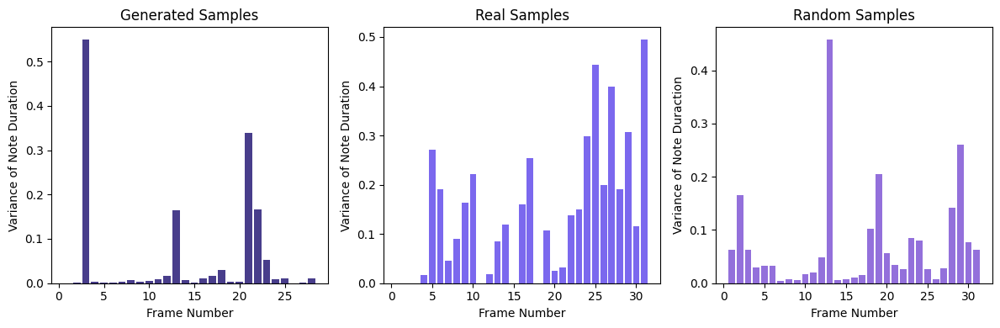

In [21]:
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.bar(np.arange(1, len(histogram_gen['vd'])+1), histogram_gen['vd'], color='darkslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Variance of Note Duration')
plt.title("Generated Samples")

plt.subplot(1,3,2)
plt.bar(np.arange(1, len(histogram_real['vd'])+1), histogram_real['vd'], color='mediumslateblue')
plt.xlabel('Frame Number')
plt.ylabel('Variance of Note Duration')
plt.title("Real Samples")

plt.subplot(1,3,3)
plt.bar(np.arange(1, len(histogram_rand['vd'])+1), histogram_rand['vd'], color='mediumpurple')
plt.xlabel('Frame Number')
plt.ylabel('Variance of Note Duraction')
plt.title("Random Samples")

plt.tight_layout()
plt.show()

Below, we visualize the generated MIDI files as piano rolls, and play some samples to compare.

In [27]:
import matplotlib.pyplot as plt
import pretty_midi
import mir_eval.display
import librosa.display
import IPython.display
import os
import pypianoroll as pr

Generated Sample 1:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


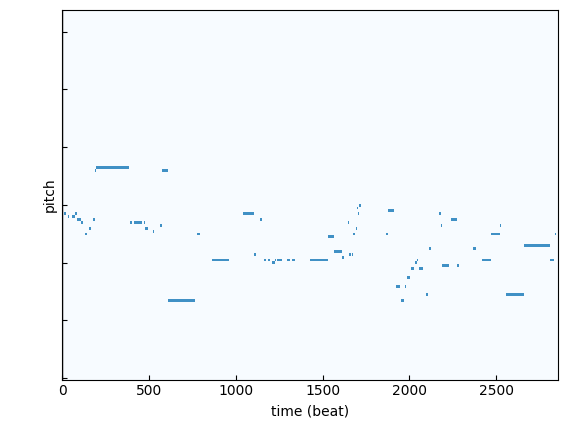

In [32]:
print("Generated Sample 1:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/gen/audio/1.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)



Random Sample 1:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


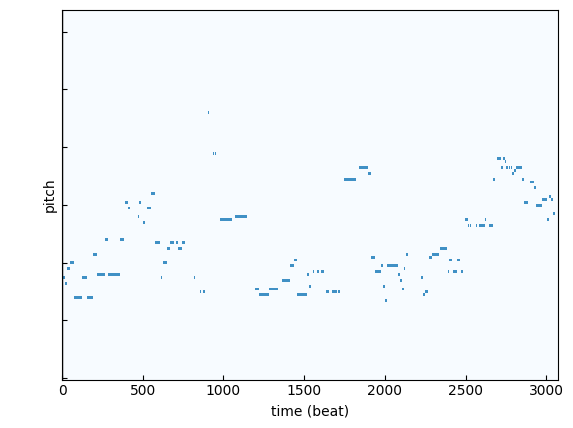

In [34]:
print("Random Sample 1:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/prior/audio/1.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Testing Sample 1:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


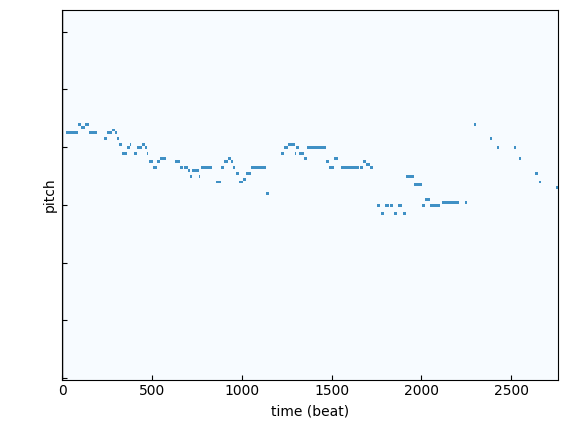

In [35]:
print("Testing Sample 1:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/real/audio/1.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Generated Sample 4:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


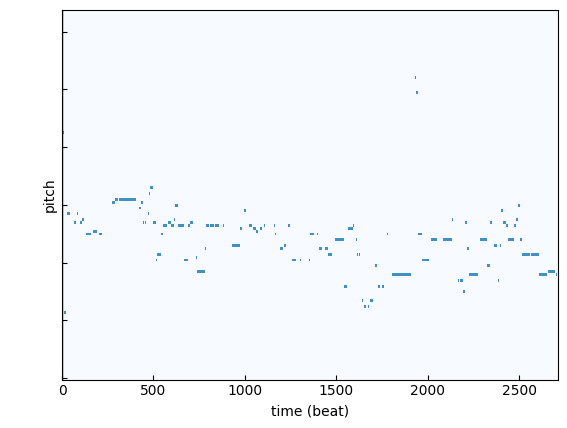

In [36]:
print("Generated Sample 4:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/gen/audio/4.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Random Sample 4:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


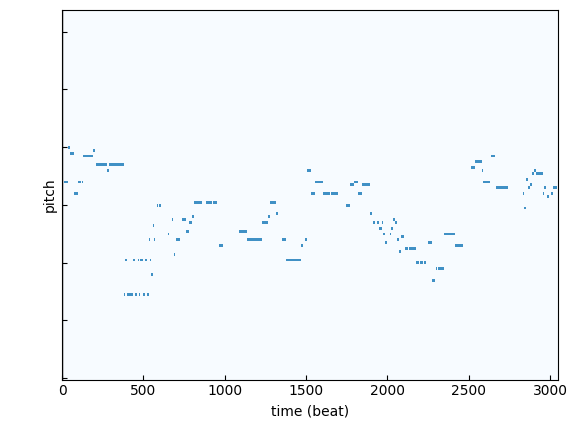

In [37]:
print("Random Sample 4:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/prior/audio/4.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Testing Sample 4:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


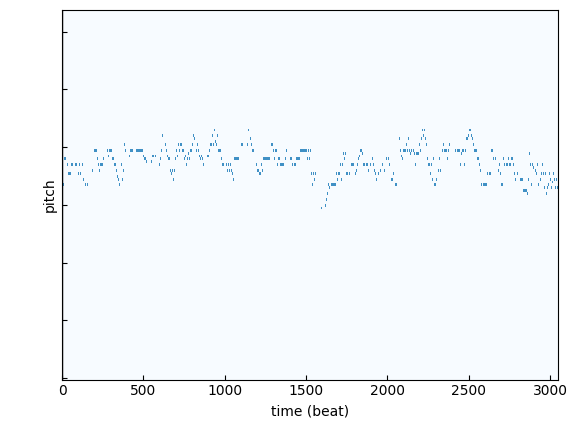

In [38]:
print("Testing Sample 4:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/real/audio/4.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Generated Sample 9:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


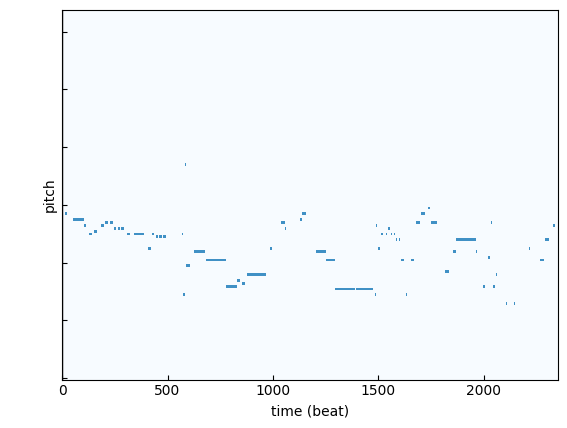

In [39]:
print("Generated Sample 9:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/gen/audio/9.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Random Sample 9:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


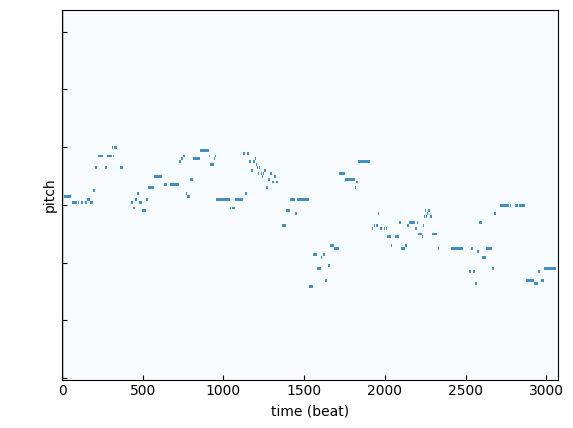

In [40]:
print("Random Sample 9:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/prior/audio/9.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)

Testing Sample 9:


fluidsynth: warning: SDL2 not initialized, SDL2 audio driver won't be usable


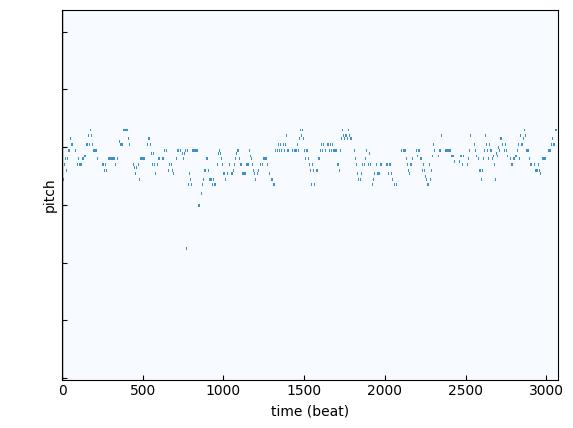

In [41]:
print("Testing Sample 9:")
midi = pretty_midi.PrettyMIDI(os.path.expanduser('~/ECE324/audio/real/audio/9.mid'))
pr.plot(pr.from_pretty_midi(midi), xtick = 'off', ytick = 'off', yticklabel = 'off', grid_axis = 'off')
IPython.display.Audio(midi.fluidsynth(fs=16000), rate=16000)